In [1]:
import torch
import clip
from PIL import Image
import os
from os.path import join, isdir, expanduser
from tqdm import tqdm
import matplotlib.pyplot as plt

data_path = expanduser('~/datasets')

# need to adapt locally

raw_image_path = ["share", "raw_images"]
construction_path = ["share", "construction"]
finished_path = ["share", "finished"]

image_files = os.listdir(join(data_path, *construction_path))


# device = "cuda" if torch.cuda.is_available() else "cpu"
# model, preprocess = clip.load("ViT-B/32", device=device)


In [41]:
from torch.utils.data import Dataset, DataLoader
from torch import nn, optim
import numpy as np
data_path = expanduser('~/datasets')

import torchvision
from datetime import datetime
from time import time, sleep

path_training_img_path = ["share", "clip_training_construction"]
# path_training_img_path = ["share", "clip_training_finished"]

In [42]:
clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [51]:
# Train over image

device = "cuda:0" if torch.cuda.is_available() else "cpu" # If using GPU then use mixed precision training.
model, preprocess = clip.load("ViT-B/32",device=device,jit=False) #Must set jit=False for training

image_files = [img for img in os.listdir(join(data_path, *path_training_img_path)) if img.endswith('.jpg')]
prompt_list = ['finished building', 'building under construction', 'construction site', 'tree', 'car', 'cat', 'table','dog']
prompt_list = [f'a photo of a {img_class}' for img_class in prompt_list]


def saver(clip, exp_id = ""):
    now = datetime.now()
    time = now.strftime("%m.%d._%H:%M")
    
    path = os.path.join("saves", exp_id, time)
    
    os.makedirs(path)
    
    torch.save(clip.state_dict(), os.path.join(path, "clip" + ".pth"))

def convert_models_to_fp32(model): 
    for p in model.parameters(): 
        p.data = p.data.float() 
        # p.grad.data = p.grad.data.float() 

epochs = 5000

#define image to optimize over
image_file = preprocess(Image.open(join(data_path, *path_training_img_path, image_files[0])))
 
image_file = image_file.clone().cuda().requires_grad_(True)# = True

#Random Image
# x = (0.1**0.5)*torch.randn(3, 256, 256)
# f_x = transforms.ToPILImage()(x)
# image_file = preprocess(f_x).clone().cuda().requires_grad_(True)

loss_img = nn.CrossEntropyLoss()
loss_txt = nn.CrossEntropyLoss()

train_loss = []

for p in model.parameters():
    p.requires_grad = False

#Optimize over Image Slice
# img_slice_a, img_slice_b, img_slice_c  = image_file[:,:,:40],image_file[:,:,40:174], image_file[:,:,174:]

# img_slice_b = img_slice_b.clone().cuda().requires_grad_(True)  
# img_slice_a = img_slice_a.clone().cuda()
# img_slice_c = img_slice_c.clone().cuda()

# print(img_slice_b.requires_grad)

optimizer = optim.Adam([image_file], lr=0.01)
# optimizer = optim.LBFGS([image_file], lr=0.01)

last_save = time()

transformed_img_list = []
img_before_optimizing = image_file.clone()
transformed_img_list.append(torchvision.utils.make_grid(img_before_optimizing, padding=2, normalize=True))

for epoch in range(epochs):
    epoch_loss = []
    # image_file = torch.cat((img_slice_a, img_slice_b,img_slice_c),2)# x = (0.1**0.5)*torch.randn(3, 256, 256)

    # def closure():
        # correct the values of updated input image
        # with torch.no_grad():
            # image_file.clamp_(0, 1)

    optimizer.zero_grad()

    images,texts = image_file,prompt_list 

    images= images.unsqueeze(0).expand(8,-1,-1,-1).to(device)
    texts = clip.tokenize(texts).to(device)

    img_features = model.encode_image(images).norm(dim=-1, keepdim=True).float()
    text_features = model.encode_text(texts).norm(dim=-1, keepdim=True).float()
    similarity = (100.0 * img_features @ text_features.T)#.softmax(dim=-1)

    # if epoch % 20 ==  19:
    #     print(similarity.softmax(dim=-1))

    ground_truth_text = torch.tensor([0,0,0,0,0,0,0,0],dtype=torch.long).to(device)
    # ground_truth_text = torch.tensor([1,1,1,1,1,1,1,1],dtype=torch.long).to(device)

    loss_first = loss_img(similarity,ground_truth_text)
    # loss_second = loss_txt(text_features,ground_truth_text)

    # print(f"loss_first {loss_first} ")
    # print(f"loss_second {loss_second} ")

    # total_loss = (loss_first + loss_second) / 2
    total_loss = loss_first


    epoch_loss.append(total_loss)

    if epoch % 20 == 19:    
        print('[%d, ] loss: %f' %
              (epoch + 1, (sum(epoch_loss) / len(epoch_loss))))
        img_after_optimizing = image_file.clone()
        transformed_img_list.append(torchvision.utils.make_grid(img_after_optimizing, padding=2, normalize=True))


    total_loss.backward()


    # return total_loss

        
    # total_loss.backward()
    
    optimizer.step(closure)

    # if device == "cpu":
    #     optimizer.step()
    # else: 
    #     convert_models_to_fp32(model)
    #     optimizer.step()
    #     # convert back to fp16
    #     clip.model.convert_weights(model)
    # # save model after every 100 epochs
    
    
    
    if time() - last_save >= 300:
        last_save = time()
        saver(model, "01_Clip")

    

    train_loss.append((sum(epoch_loss) / len(epoch_loss)).detach().cpu().numpy())
# saver(model, "01_Clip")


[20, ] loss: 240.893555
[20, ] loss: 316.809082
[40, ] loss: 169.299316
[40, ] loss: 221.710205
[60, ] loss: 134.134033
[60, ] loss: 175.587524
[80, ] loss: 114.971924
[80, ] loss: 149.771118
[100, ] loss: 100.126587
[100, ] loss: 129.744690
[120, ] loss: 94.072754
[120, ] loss: 121.633545
[140, ] loss: 89.282227
[140, ] loss: 115.264893
[160, ] loss: 78.701050
[160, ] loss: 101.728455
[180, ] loss: 70.067627
[180, ] loss: 91.216675
[200, ] loss: 67.382812
[200, ] loss: 87.738037
[220, ] loss: 64.908569
[220, ] loss: 84.108337
[240, ] loss: 62.118530
[240, ] loss: 81.047058
[260, ] loss: 62.644897
[260, ] loss: 81.267517
[280, ] loss: 56.380493
[280, ] loss: 73.563782
[300, ] loss: 56.327759
[300, ] loss: 73.366516
[320, ] loss: 55.117065
[320, ] loss: 71.735779
[340, ] loss: 62.802856
[340, ] loss: 81.346497
[360, ] loss: 52.642822
[360, ] loss: 68.725586
[380, ] loss: 60.170776
[380, ] loss: 78.577820
[400, ] loss: 51.958496
[400, ] loss: 67.699829
[420, ] loss: 50.563416
[420, ] los

In [49]:
# image_file = preprocess(Image.open(join(data_path, *path_training_img_path, image_files[0])))

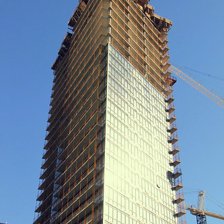

In [50]:
import torchvision.transforms as transforms

def unprocess(img):
    # img = img.permute(1,2,0)
    img = img - img.min()
    return img / img.max()

final_img = transforms.ToPILImage()(unprocess(image_file))
final_img

Animation size has reached 21151272 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


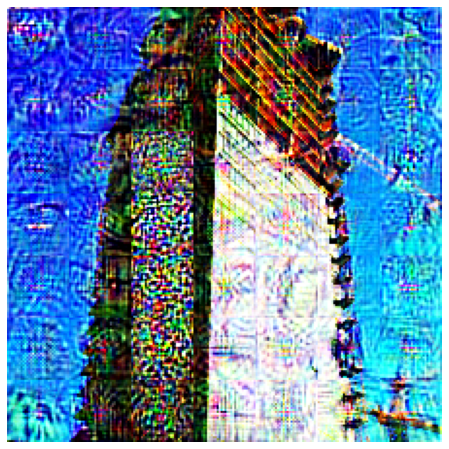

In [7]:
#%%capture
from matplotlib.animation import ArtistAnimation 
from IPython.display import HTML, display

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i.cpu().detach().numpy(),(1,2,0)), animated=True)] for i in transformed_img_list]
ani = ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())